In [33]:
!pip install keybert

In [34]:
import pandas as pd
import umap
import hdbscan
from sentence_transformers import SentenceTransformer
import plotly.express as px
from keybert import KeyBERT
import torch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
import numpy as np
import matplotlib.pyplot as plt
from wordcloud import WordCloud

In [ ]:
df = pd.read_csv("../datasets/dataset.csv")
# df.drop("Heading", axis=1, inplace=True)
df.drop("URL", axis=1, inplace=True)
df.dropna(subset=["Body", "Heading"], inplace=True)


In [36]:
embedder = SentenceTransformer('sentence-transformers/all-mpnet-base-v2', device=device)
embeddings = embedder.encode(df["Body"].values)
print(embeddings)

[[ 0.02521093  0.06471103 -0.00559264 ...  0.0063234  -0.02497388
  -0.00480216]
 [ 0.03232021  0.09577961  0.00989406 ... -0.01016361  0.01712565
  -0.00864657]
 [ 0.01764961  0.01648737 -0.03228975 ... -0.02131656 -0.04213564
   0.00423731]
 ...
 [ 0.07933716 -0.02790488 -0.03348327 ...  0.02455924 -0.04074052
  -0.00059802]
 [ 0.03438435  0.01583013 -0.01504164 ... -0.02020227 -0.12567331
  -0.02509151]
 [-0.00623392  0.04400329 -0.00808281 ... -0.00081382 -0.05484553
  -0.01530094]]


In [ ]:
np.save('../datasets/embeddings_body.npy', embeddings)

In [38]:
print(embeddings.shape)

(11583, 768)


In [39]:
reduced_embeddings = umap.UMAP(n_components=2, n_neighbors=100, min_dist=0.02).fit_transform(embeddings)
print(reduced_embeddings.shape)

(11583, 2)


In [40]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=35)
labels = clusterer.fit_predict(reduced_embeddings)
df["label"] = [str(label) for label in labels]
print(f"Num of clusters: {labels.max()}")

Num of clusters: 51


In [41]:
# put the values of the two dimensions inside the dataframe
df["x"] = reduced_embeddings[:, 0]
df["y"] = reduced_embeddings[:, 1]
# substring of the full text, for visualization purposes
df["text_short"] = df["Body"].str[:200]

In [42]:
hover_data = {
    "text_short": True,
    "x": False,
    "y": False
}
fig = px.scatter(df, x="x", y="y", template="plotly_dark",
                   title="Embeddings", hover_data=hover_data)
fig.update_layout(showlegend=False)
fig.show()

In [43]:
num_outliers = len(df[df["label"] == "-1"])
print(f"Num of outliers: {num_outliers} ({num_outliers / len(df) * 100:.2f} % of total)")

Num of outliers: 3198 (27.61 % of total)


In [44]:
df_no_outliers = df[df["label"] != "-1"]

# scatter plot
hover_data = {
    "text_short": True,
    "x": False,
    "y": False
}
fig = px.scatter(df_no_outliers, x="x", y="y", template="plotly_dark",
                   title="Embeddings", color="label", hover_data=hover_data)
fig.show()

In [45]:
cluster = "1"
df_subset = df[df["label"] == cluster].reset_index()
texts_concat = ". ".join(df_subset["Heading"].values)
keywords_and_scores = KeyBERT().extract_keywords(texts_concat,
                                    keyphrase_ngram_range=(1, 1), top_n=10)
print(keywords_and_scores)

[('ufo', 0.4495), ('nasa', 0.4256), ('ufos', 0.4238), ('extraterrestrial', 0.4153), ('nasas', 0.4082), ('aliens', 0.3973), ('spacecraft', 0.3804), ('moon', 0.3783), ('alien', 0.3741), ('lunar', 0.3637)]


In [46]:
def filter_keywords(keywords, n_keep=3):
    new_keywords = []
    for candidate_keyword in keywords:
        is_ok = True
        for compare_keyword in keywords:
            if candidate_keyword == compare_keyword:
                continue
            if compare_keyword in candidate_keyword:
                is_ok = False
                break
        if is_ok:
            new_keywords.append(candidate_keyword)
            if len(new_keywords) >= n_keep:
                break
    return new_keywords

keywords = [t[0] for t in keywords_and_scores]
keywords_filtered = filter_keywords(keywords)
print(keywords_filtered)

['ufo', 'nasa', 'extraterrestrial']


In [47]:
df_no_outliers

,Heading,Body,label,x,y,text_short
1,comment take context say us cop mock indian st...,seattle police officer guild friday come defen...,41,12.311295,-4.063141,seattle police officer guild friday come defen...
2,first meeting one nation one election committe...,first official meeting one nation one election...,49,14.151288,-1.104230,first official meeting one nation one election...
4,terrorist kill security force foil infiltratio...,three terrorist kill infiltration bid foil sec...,35,11.514887,-3.870420,three terrorist kill infiltration bid foil sec...
5,probe agency summon tiger shroff sunny leone l...,enforcement directorate ed likely summon top b...,40,12.709327,-3.553847,enforcement directorate ed likely summon top b...
6,anantnag encounter day explosion hear search t...,loud explosion hear drone press service pinpoi...,35,11.542542,-3.846198,loud explosion hear drone press service pinpoi...
...,...,...,...,...,...,...
11575,train shooting put focus rpf force,new delhi july railway protection force rpf co...,41,12.463427,-4.112099,new delhi july railway protection force rpf co...
11577,juif party target pakistan suicide bombing har...,new delhi least people kill another injure sui...,35,11.542053,-3.794818,new delhi least people kill another injure sui...
11578,constitutional statutory right vote status con...,new delhi paradoxical right vote not assign st...,40,13.559418,-3.036552,new delhi paradoxical right vote not assign st...
11579,face north korea threat deploy missile defence...,us thaad system missile range km reach height ...,26,9.290265,-3.422136,us thaad system missile range km reach height ...


In [48]:
# assign a meaningful name to each cluster
def get_cluster_name(df, cluster):
    df_subset = df[df["label"] == cluster].reset_index()
    texts_concat = ". ".join(df_subset["Heading"])
    kw_model = KeyBERT()
    keywords_and_scores = kw_model.extract_keywords(texts_concat, keyphrase_ngram_range=(1, 1),
                                        top_n=10)
    keywords = [t[0] for t in keywords_and_scores]
    keywords_filtered = filter_keywords(keywords)
    return " - ".join(keywords_filtered)

# get all the new cluster names
all_clusters = df_no_outliers["label"].unique()
d_cluster_name_mapping = {}
for cluster in all_clusters:
    if cluster == "-1":
        d_cluster_name_mapping[cluster] = "outliers"
    else:
        d_cluster_name_mapping[cluster] = get_cluster_name(df_no_outliers, cluster)

# rename clusters
df_no_outliers["label"] = df_no_outliers["label"].apply(lambda label: d_cluster_name_mapping[label])

<ipython-input-48-47c9c52a62c3>:22: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



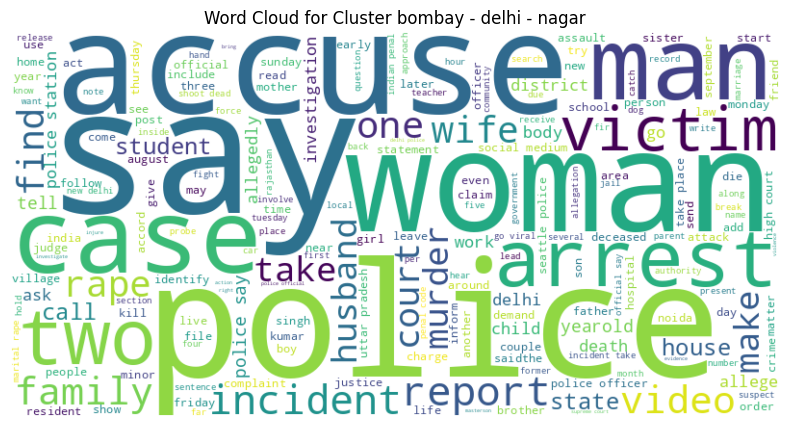

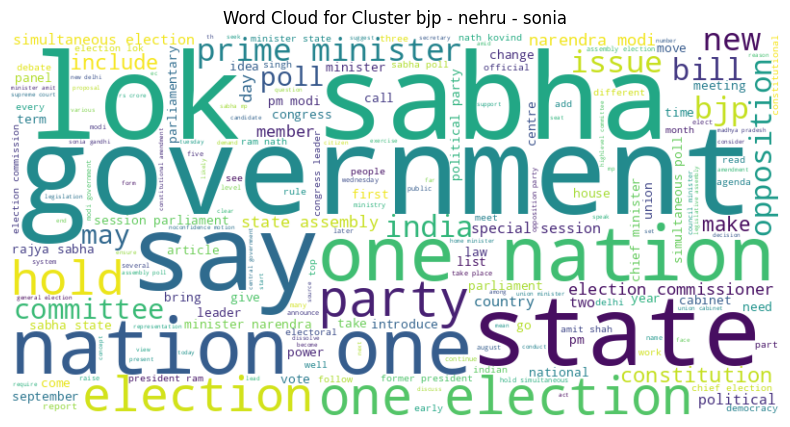

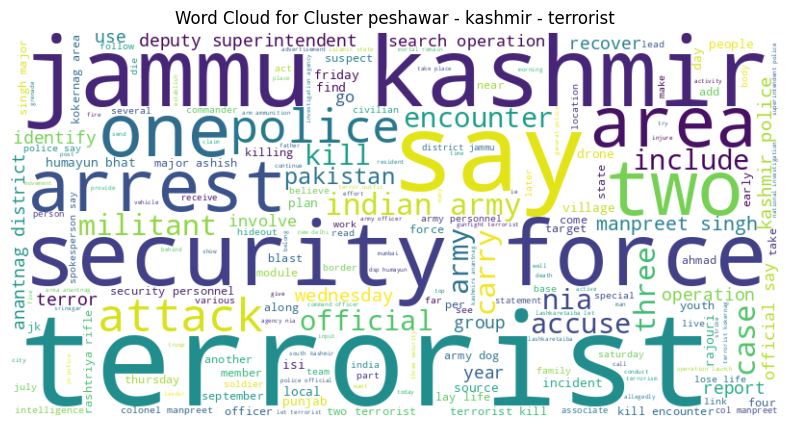

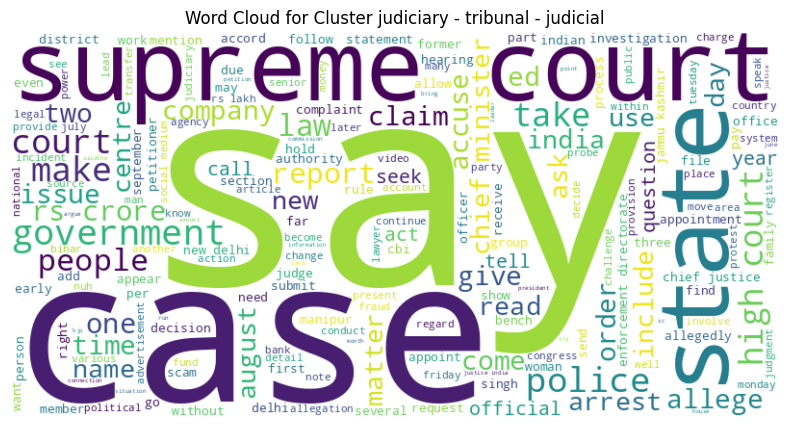

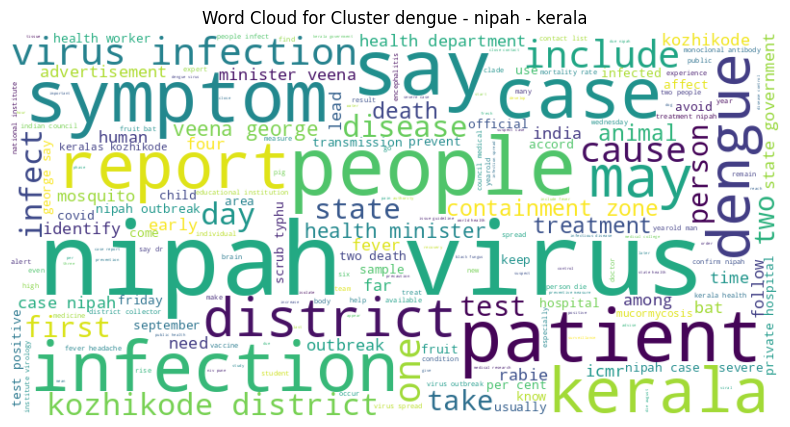

...

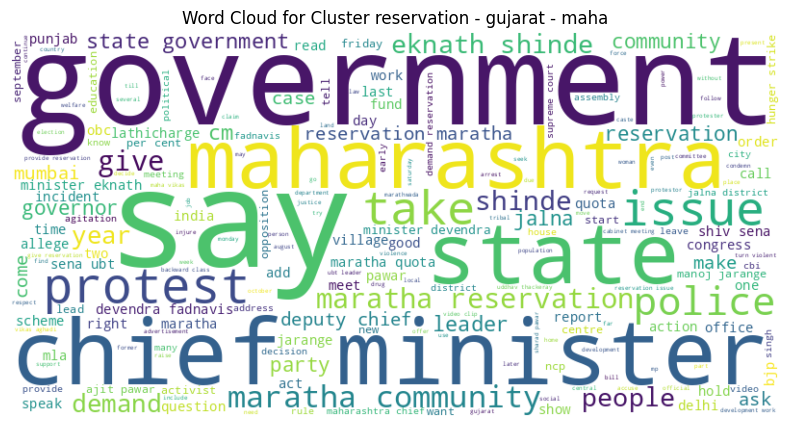

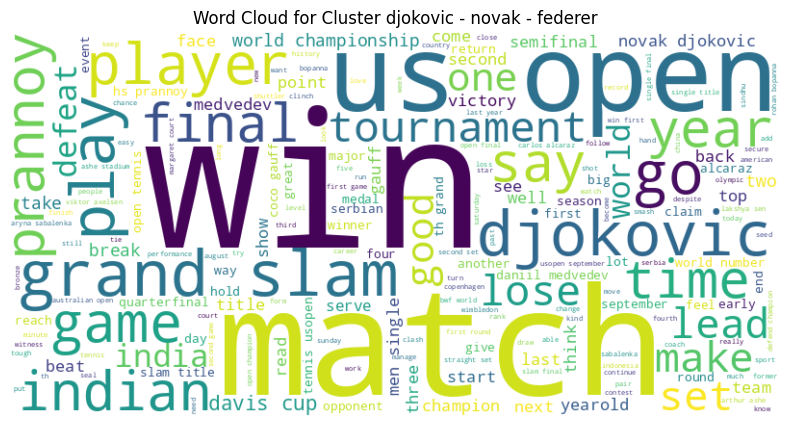

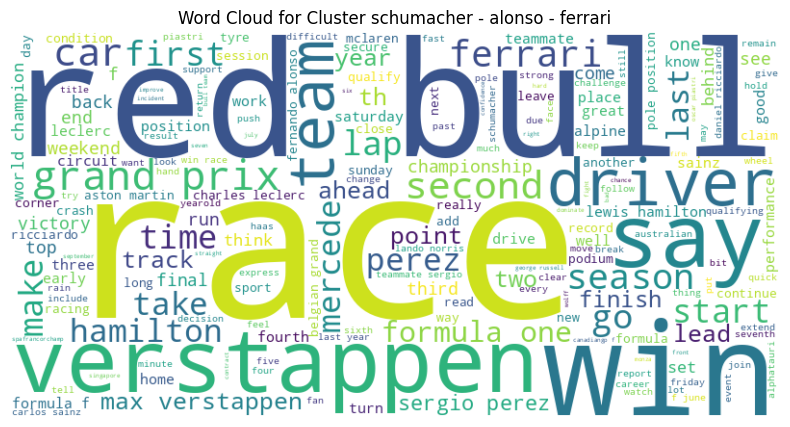

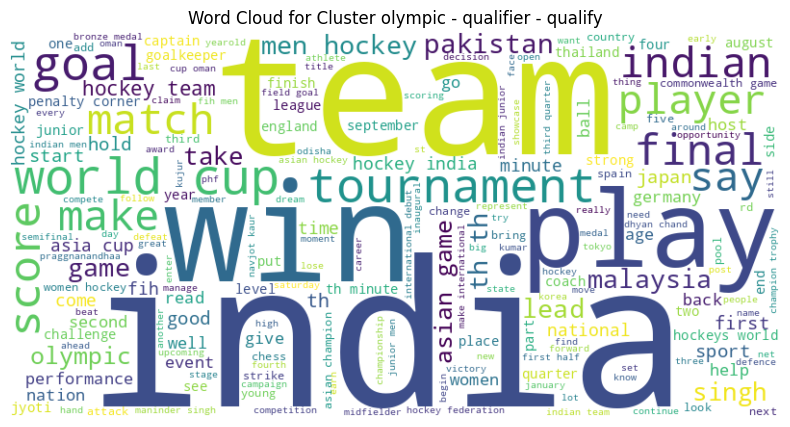

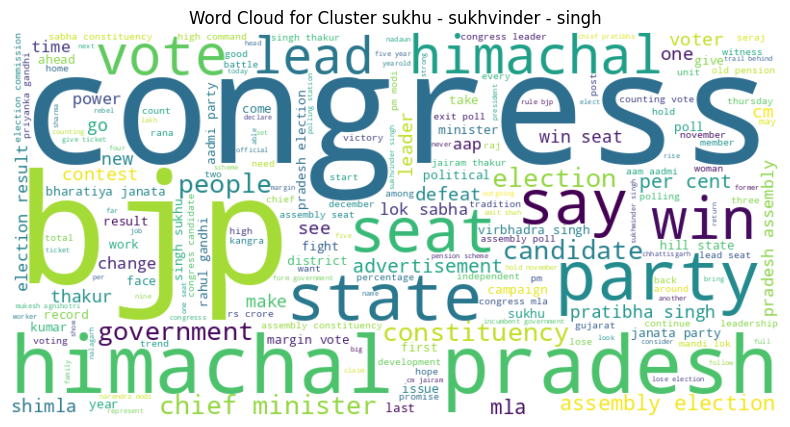

In [49]:
clusters = df_no_outliers['label'].unique()

for cluster in clusters:
    # Combine all text for a specific cluster
    cluster_text = ' '.join(df_no_outliers[df_no_outliers['label'] == cluster]['Body'])

    # Generate a word cloud for the cluster's text
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(cluster_text)

    # Display the word cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for Cluster {cluster}')
    plt.axis('off')
    plt.show()

In [50]:
# prompt: save the clustering model and the mapping required to understand the clustring model

import pickle

# Save the clustering model
with open('clustering_model.pkl', 'wb') as f:
    pickle.dump(clusterer, f)

# Save the cluster name mapping
with open('cluster_name_mapping.pkl', 'wb') as f:
    pickle.dump(d_cluster_name_mapping, f)
